In [ ]:
import torch
print(torch.version.cuda)
print(torch.cuda.is_available())
print(torch.cuda.device_count())

In [1]:
import sys
import os
import pickle
import logging
logging.getLogger('matplotlib.font_manager').disabled = True

# Add the src directory to sys.path
src_path = os.path.abspath(os.path.join(os.getcwd(), '..'))
sys.path.append(src_path)

from src.IndependentSteps import Pycromanager2NativeDataType, FFF2NativeDataType, Make_Output_Dir_JF, Make_Analysis_Dir_JF, \
                                    ConsolidateImageShapes, TrimZSlices, AutomaticSpotDetection_JF

from src.SequentialSteps import CellSegmentationStepClass_JF, BIGFISH_SpotDetection, SimpleCellposeSegmentaion, illumination_correction

from src.FinalizationSteps import BuildPDFReport, SaveSpotDetectionResults, SaveMasksToAnalysis, SendAnalysisToNAS

from src import Experiment, Settings, ScopeClass, Pipeline, DataContainer

print('Will it blend?')

Will it blend?


In [3]:
# raw_data_dir = r'smFISH_images\Eric_smFISH_images\20230511\DUSP1_DexTimeConcSweep_10nM_75min_041223'

# #Build Experiment Class
# experiment = Experiment()
# experiment.initial_data_location = raw_data_dir
# experiment.nucChannel = [2]
# experiment.cytoChannel = [1]
# experiment.FISHChannel = [0]

# # define output directory
# output_dir = r'output'

# images = experiment.initial_data_location

# # Define the FISH channel
# FISHChannel = experiment.FISHChannel

# # Instantiate the class
# correction = Filters.exposure_correction()

# # Test the correction without saving images
# corrected_images = correction.main(images, FISHChannel, sigma=50, output_dir=output_dir, save_images=False, display_plots=True)

In [ ]:
## BigFish Spot Detection w/out Illumination Correction

# # raw_data_dir = r'C:\Users\Jack\Desktop\H128_Tiles_100ms_5mW_Blue_15x15_10z_05step_2'
raw_data_dir = r'smFISH_images\Eric_smFISH_images\20230511\DUSP1_DexTimeConcSweep_10nM_75min_041223'
#Build Experiment Class
experiment = Experiment()
experiment.initial_data_location = raw_data_dir
experiment.nucChannel = [2]
experiment.cytoChannel = [1]
experiment.FISHChannel = [0]


# Build Confocal Scope Class
confocal = ScopeClass()
confocal.voxel_size_yx = 160
confocal.voxel_size_z = 500
confocal.spot_yx = 320
confocal.spot_z = 750



# Build Setting Classes
pipelineSettings = Settings(user_select_number_of_images_to_run=5, local_or_NAS=0, load_in_mask = True)
pipelineSettings.bigfish_alpha = 0.6
pipelineSettings.bigfish_beta = 2
pipelineSettings.bigfish_gamma = 5
pipelineSettings.CLUSTER_RADIUS = 500
pipelineSettings.MIN_NUM_SPOT_FOR_CLUSTER = 4
# pipelineSettings.bigfish_threshold = '90th_percentile' #'median_threshold'
pipelineSettings.display_plots = True
pipelineSettings.verbose = True
pipelineSettings.snr_threshold = 4

pipelineData = DataContainer()

# Create Pipeline 
prePipelineSteps = [FFF2NativeDataType()]
pipelineSteps = [BIGFISH_SpotDetection()]
postPipelineSteps = [BuildPDFReport(), SaveSpotDetectionResults(), SaveMasksToAnalysis()]
pipeline = Pipeline(pipelineSettings, confocal, experiment, pipelineData, prePipelineSteps, postPipelineSteps, pipelineSteps)

In [ ]:
# BigFish Spot Detection w/ Illumination Correction Build Experiment Class, Confocal Scope Class, Setting Classes, and Pipeline
raw_data_dir = r'smFISH_images\Eric_smFISH_images\20230511\DUSP1_DexTimeConcSweep_10nM_75min_041223'

#Build Experiment Class
experiment = Experiment()
experiment.initial_data_location = raw_data_dir
experiment.nucChannel = [2]
experiment.cytoChannel = [1]
experiment.FISHChannel = [0]


# Build Confocal Scope Class
confocal = ScopeClass()
confocal.voxel_size_yx = 160
confocal.voxel_size_z = 500
confocal.spot_yx = 480
confocal.spot_z = 750



# Build Setting Classes
pipelineSettings = Settings(user_select_number_of_images_to_run=5, local_or_NAS=0, load_in_mask = True)
pipelineSettings.bigfish_alpha = 0.6
pipelineSettings.bigfish_beta = 2
pipelineSettings.bigfish_gamma = 5
pipelineSettings.CLUSTER_RADIUS = 500
pipelineSettings.MIN_NUM_SPOT_FOR_CLUSTER = 4
# pipelineSettings.bigfish_threshold = '90th_percentile' #'median_threshold'
pipelineSettings.display_plots = True
pipelineSettings.verbose = True
pipelineSettings.snr_threshold = 4
# pipelineSettings.snr_ratio = 0.9

# Trackpy settings
pipelineSettings.spot_yx_px = 5
pipelineSettings.spot_z_px = 3
pipelineSettings.trackpy_use_pca = True




pipelineData = DataContainer()

# Create Pipeline 
prePipelineSteps = [FFF2NativeDataType(), Make_Output_Dir_JF(), Make_Analysis_Dir_JF(), illumination_correction()] # AutomaticSpotDetection_JF()]
pipelineSteps = [BIGFISH_SpotDetection()] #SimpleCellposeSegmentaion(),
postPipelineSteps = [BuildPDFReport(), SaveSpotDetectionResults(), SaveMasksToAnalysis()]
pipeline = Pipeline(pipelineSettings, confocal, experiment, pipelineData, prePipelineSteps, postPipelineSteps, pipelineSteps)




The following parameters are required in the run the pipeline
['FISHChannel', 'spot_yx', 'df_spotresults', 'list_images', 'id', 'voxel_size_z', 'kwargs', 'df_clusterresults', 'df_cellresults', 'cytoChannel', 'initial_data_location', 'nucChannel', 'map_id_imgprops', 'voxel_size_yx', 'analysis_location', 'output_location', 'spot_z']
FFF2NativeDataType
FFF2NativeDataType did not return a value
Make_Output_Dir_JF
Make_Analysis_Dir_JF
illumination_correction
Starting illumination correction...
Calculating average illumination profile...


DEBUG:matplotlib.pyplot:Loaded backend module://matplotlib_inline.backend_inline version unknown.
DEBUG:matplotlib.pyplot:Loaded backend module://matplotlib_inline.backend_inline version unknown.
DEBUG:matplotlib.colorbar:locator: <matplotlib.ticker.AutoLocator object at 0x30237d040>


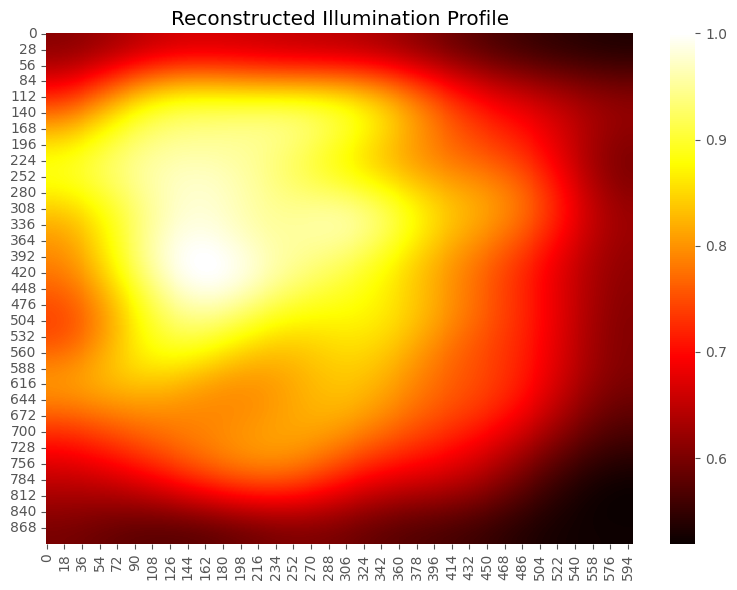

Starting image correction...
Processing image 1/30...


<Figure size 640x480 with 0 Axes>

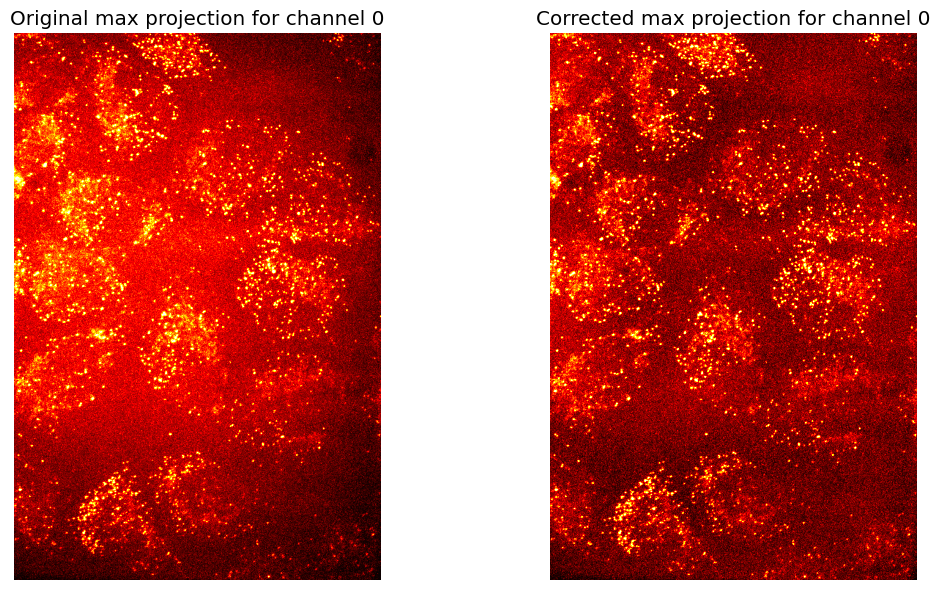

Processing image 2/30...


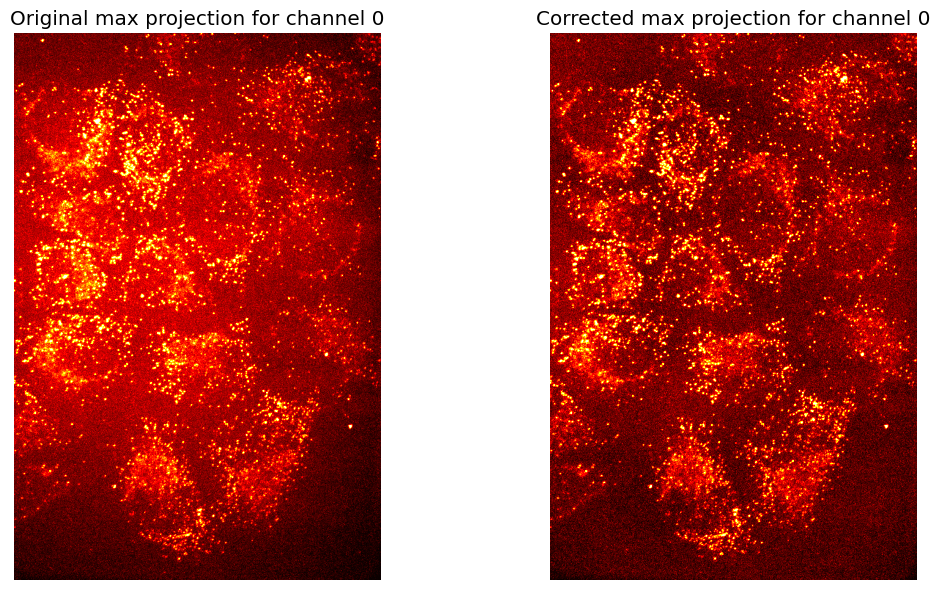

Processing image 3/30...


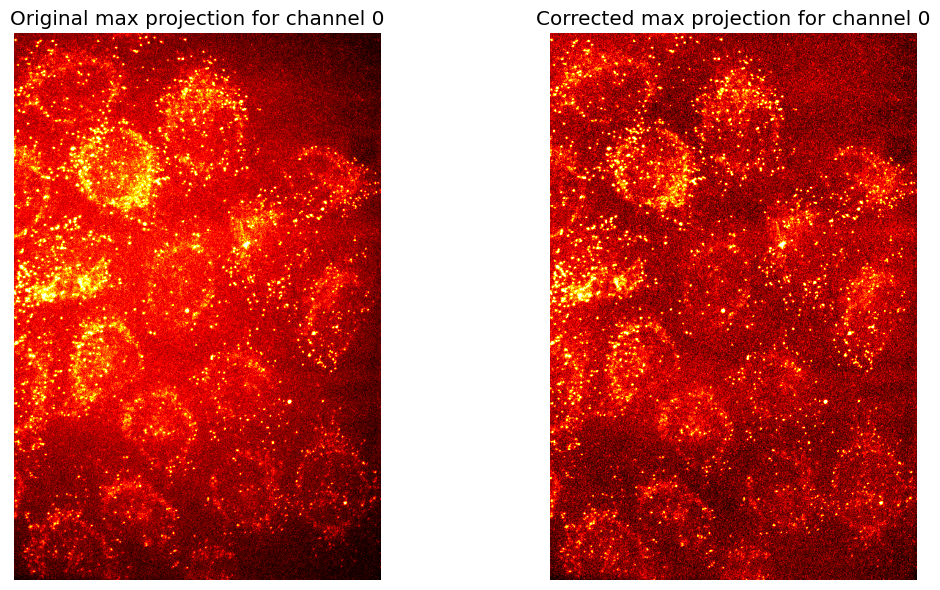

Processing image 4/30...


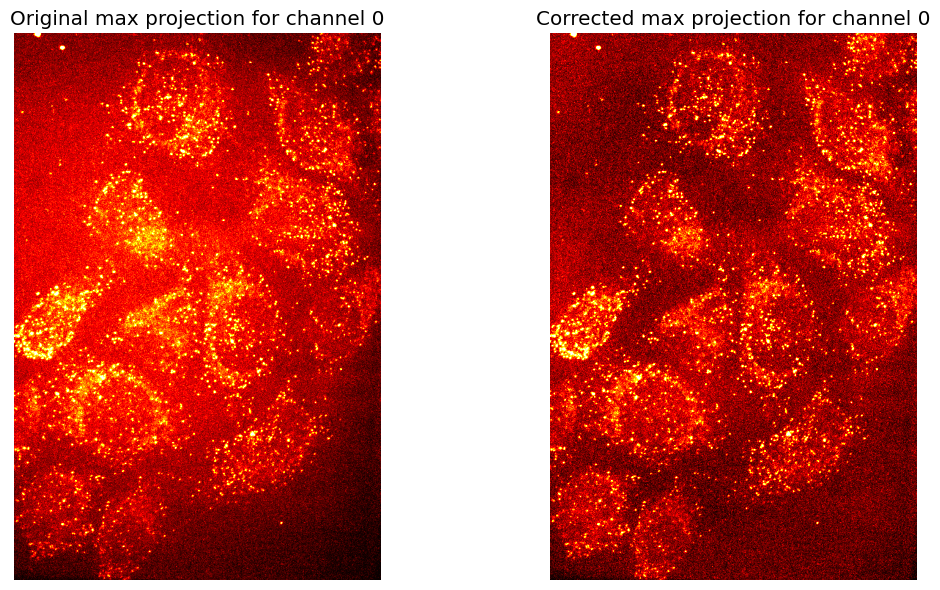

Processing image 5/30...


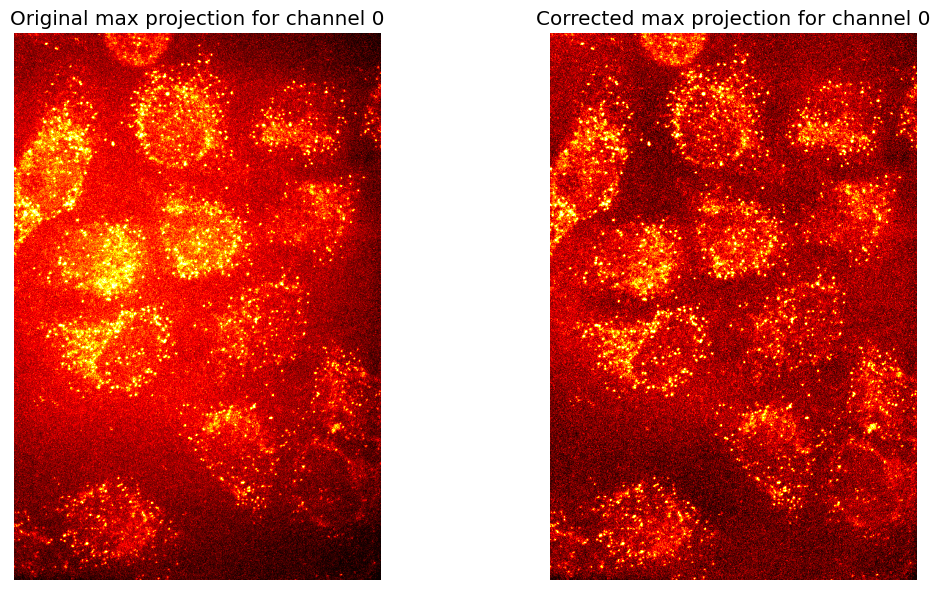

Processing image 6/30...


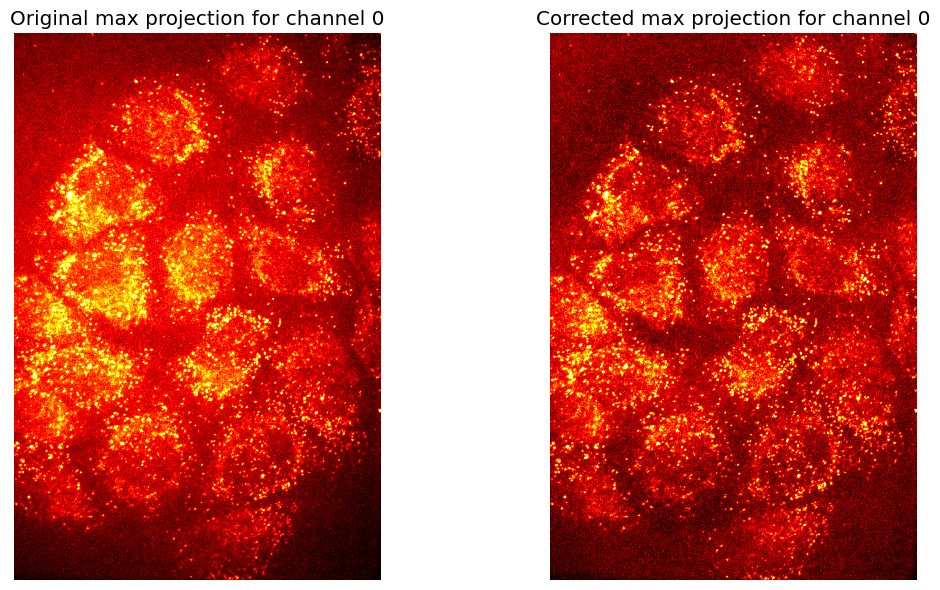

Processing image 7/30...


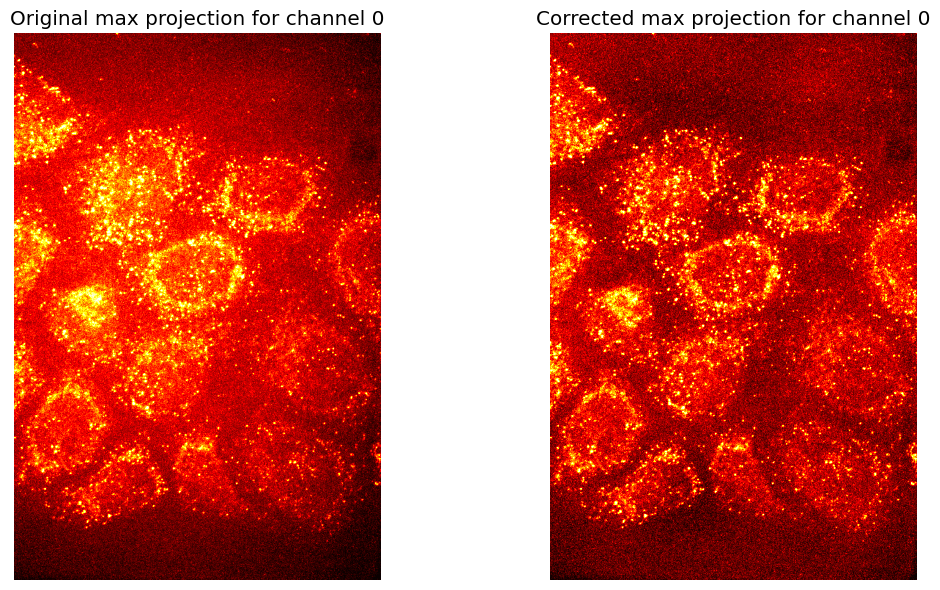

Processing image 8/30...


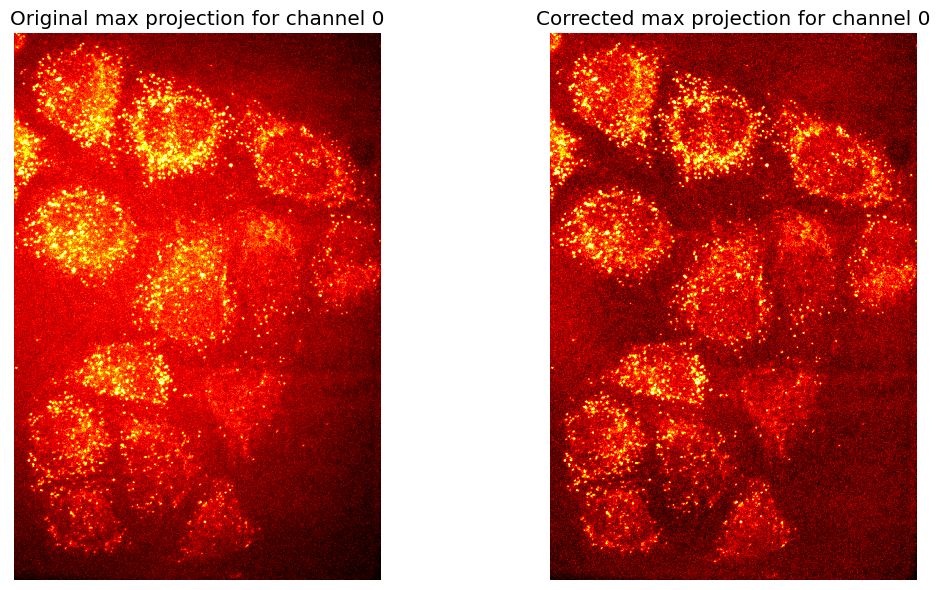

Processing image 9/30...


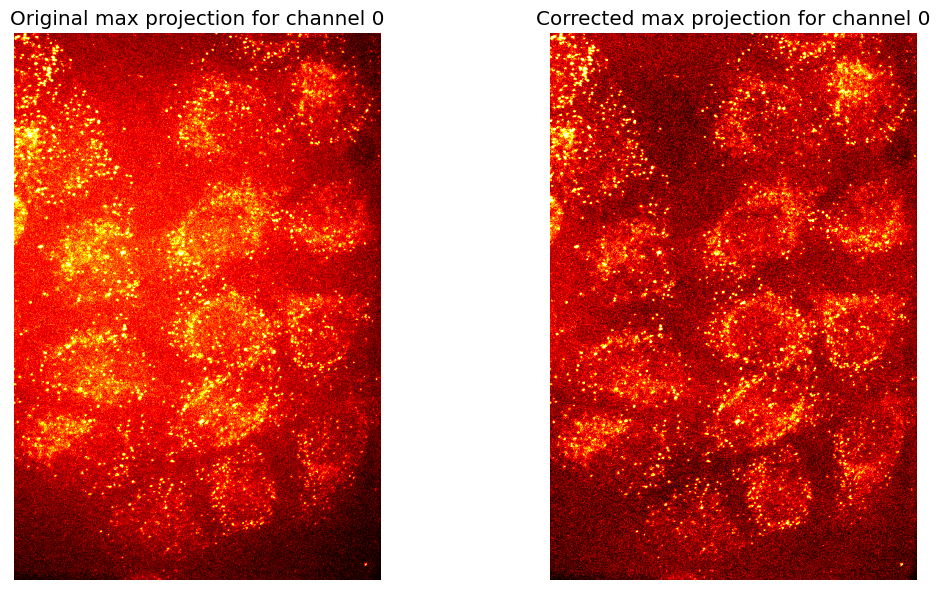

Processing image 10/30...


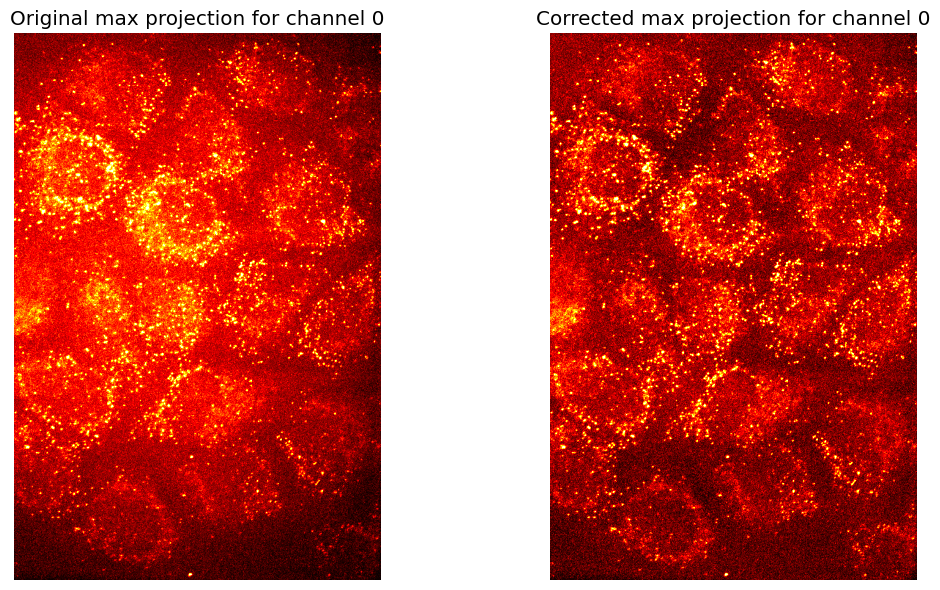

Processing image 11/30...


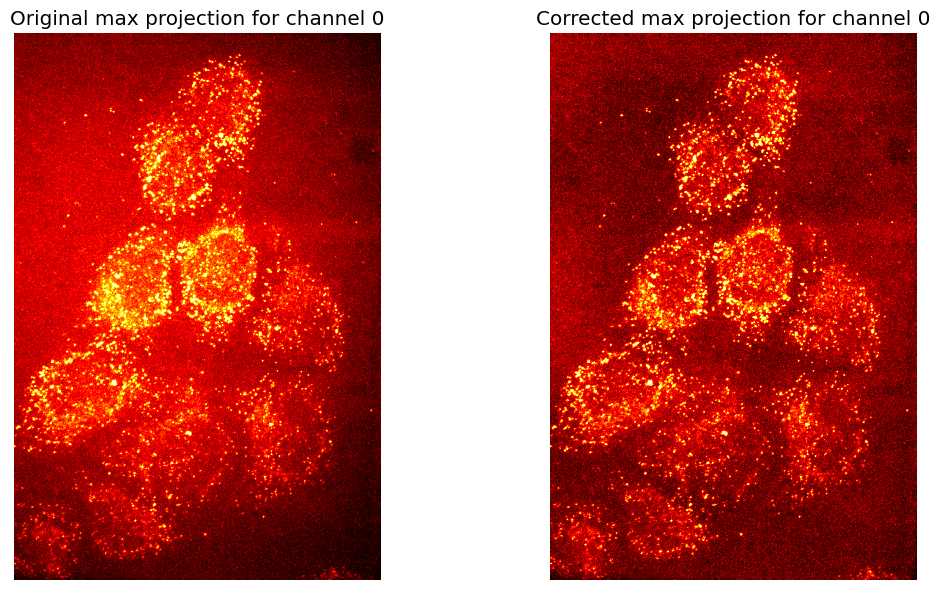

Processing image 12/30...


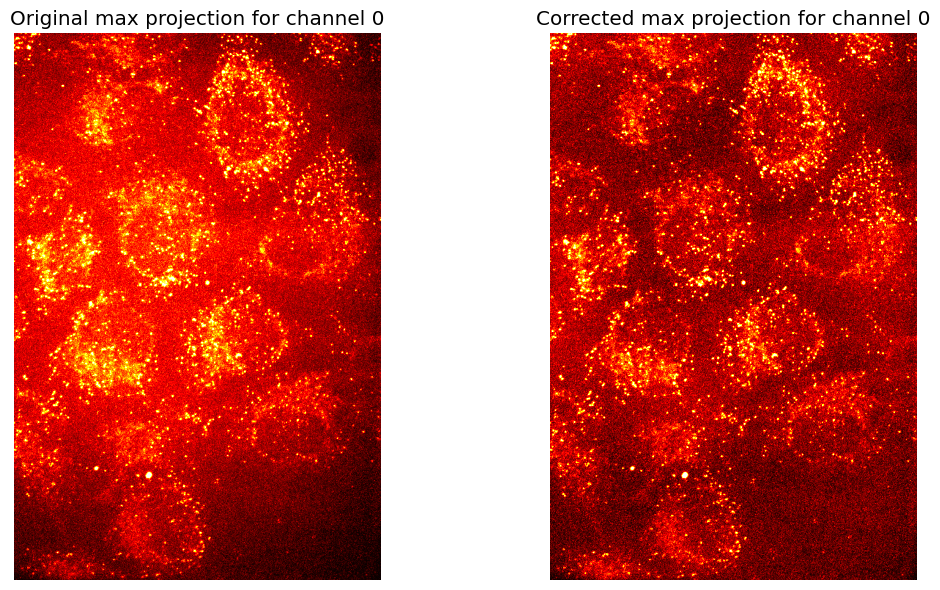

Processing image 13/30...


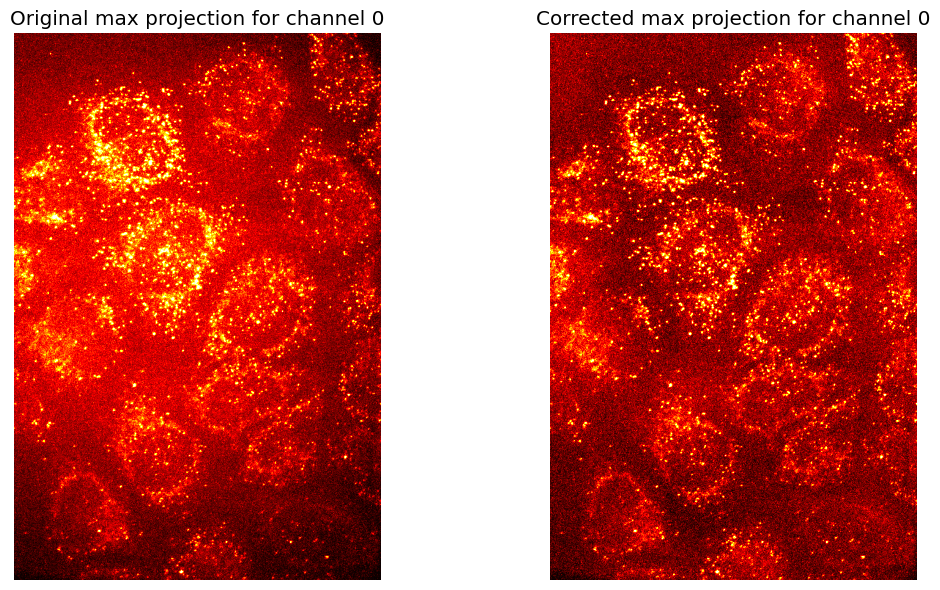

Processing image 14/30...


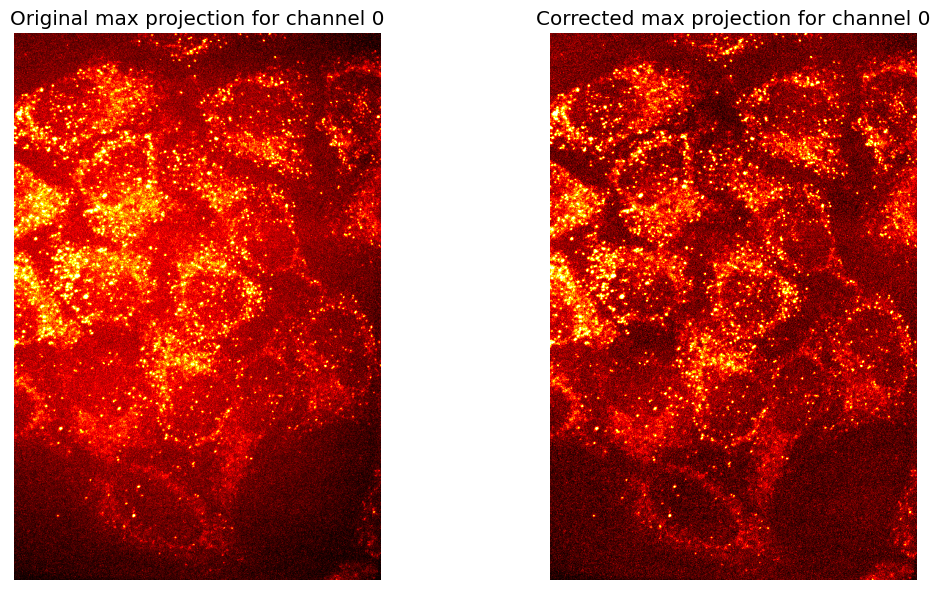

Processing image 15/30...


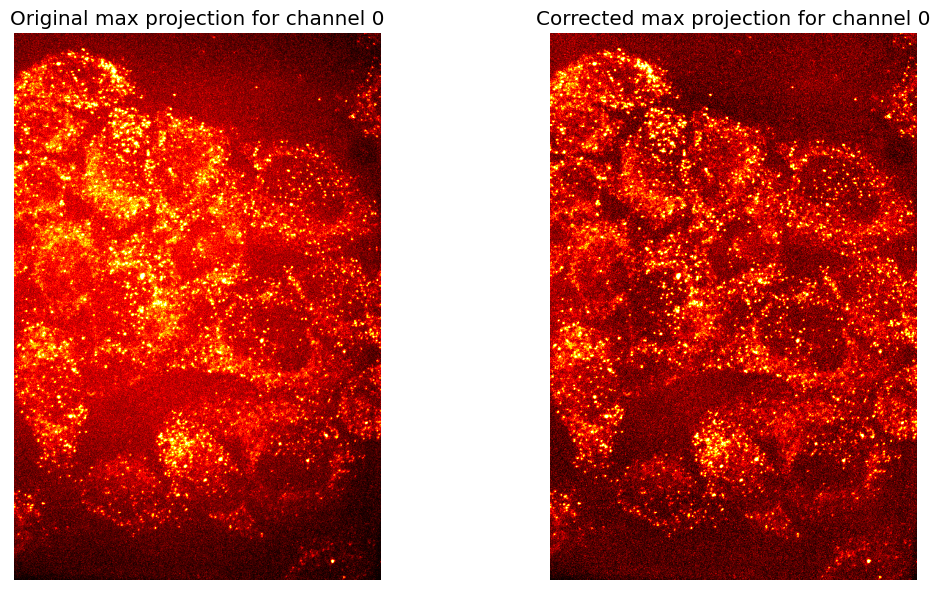

Processing image 16/30...


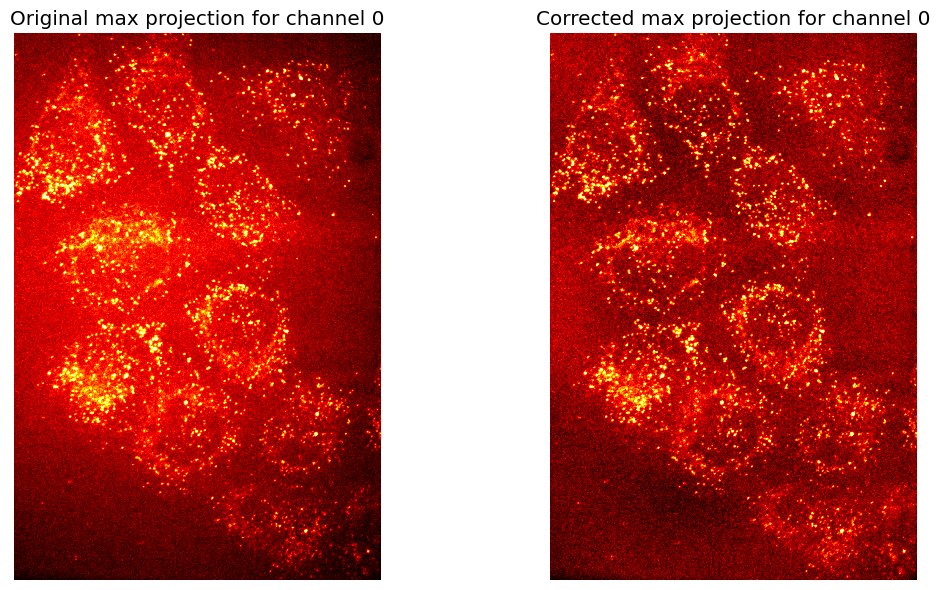

Processing image 17/30...


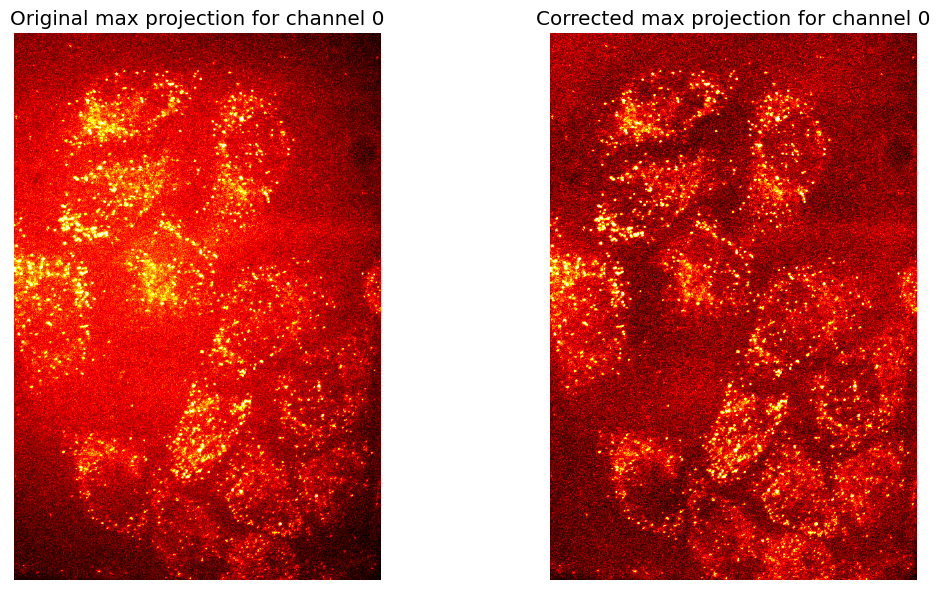

Processing image 18/30...


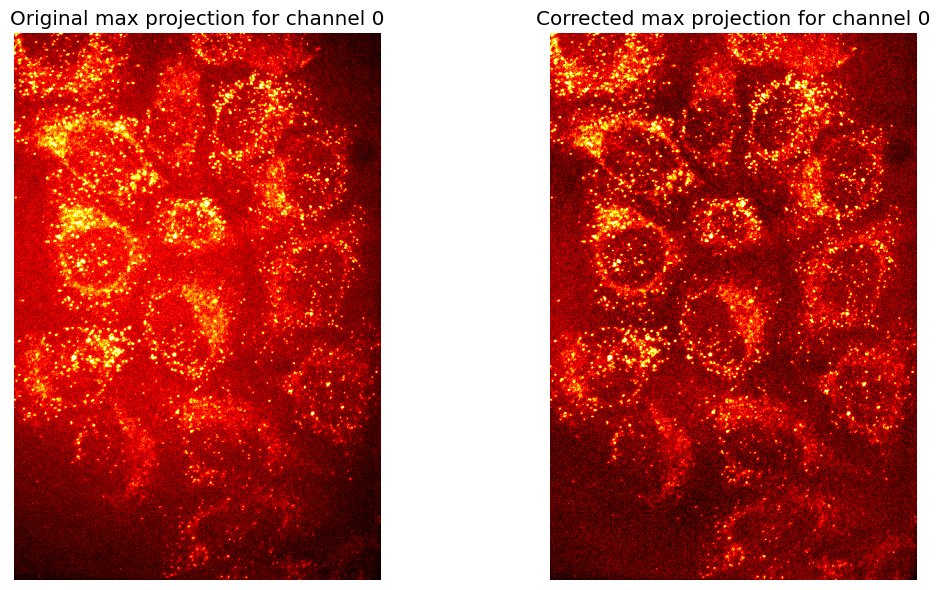

Processing image 19/30...


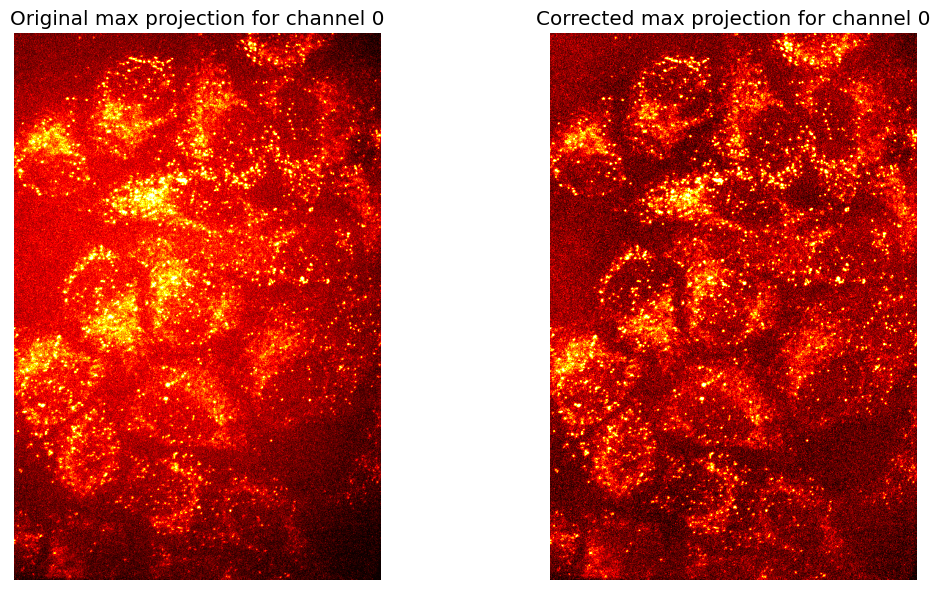

Processing image 20/30...


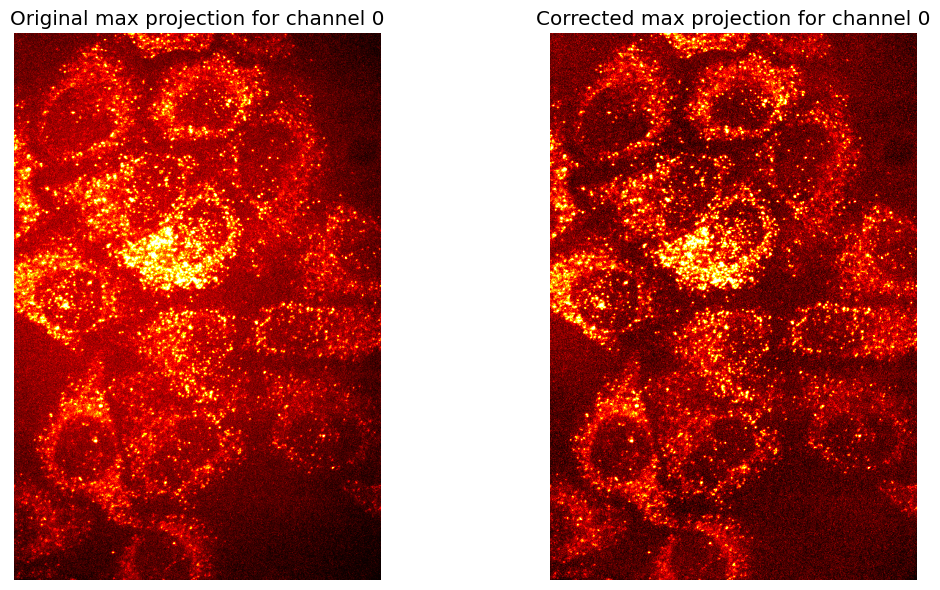

Processing image 21/30...


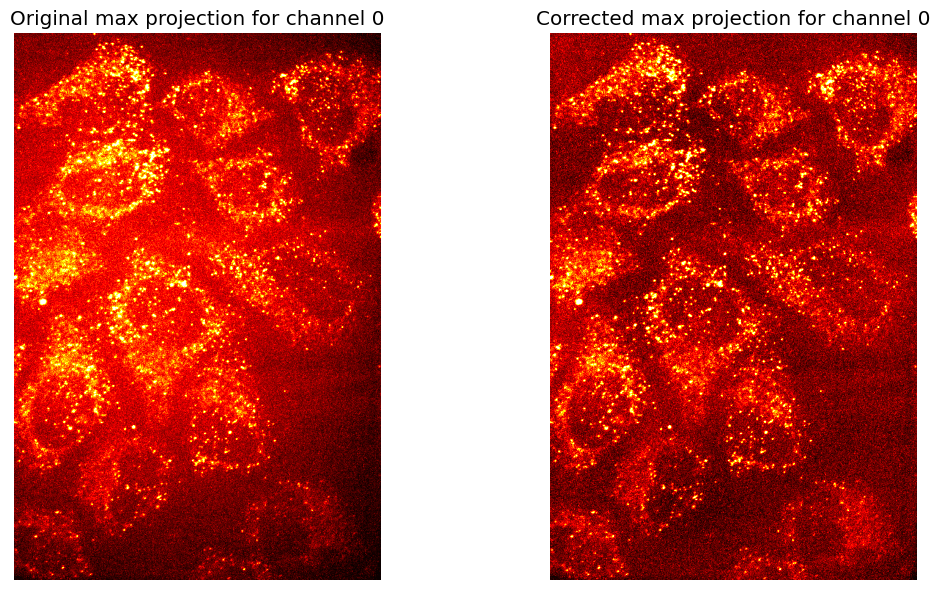

Processing image 22/30...


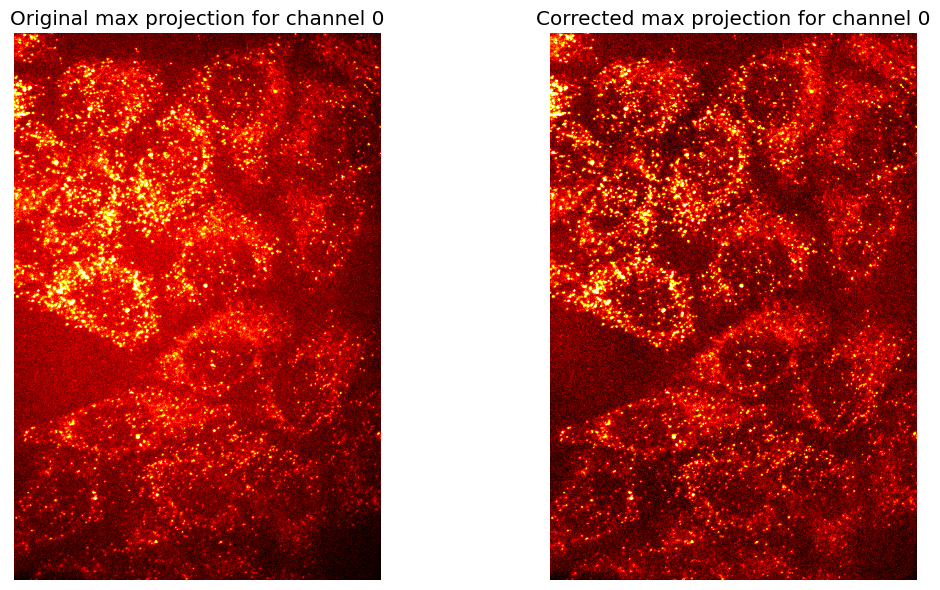

Processing image 23/30...


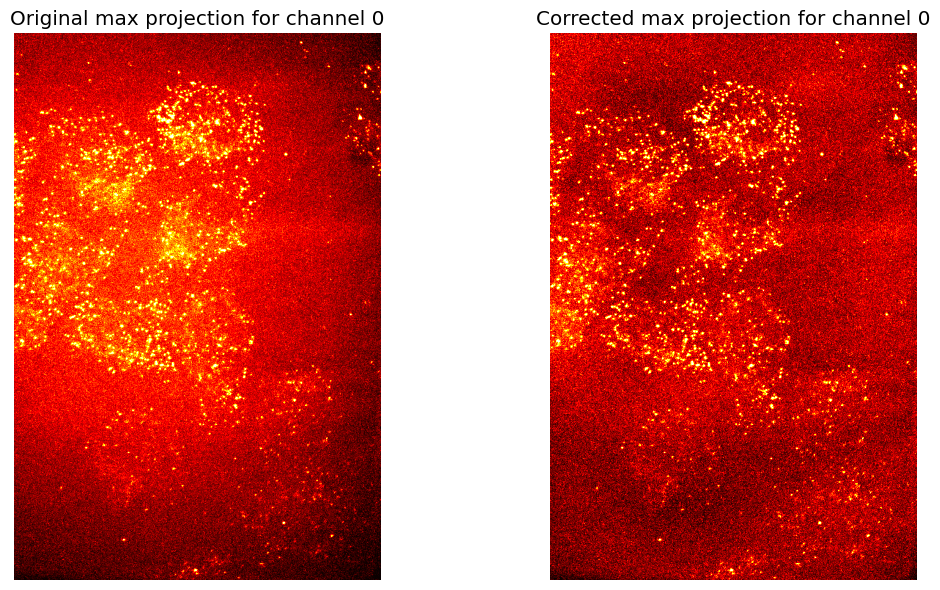

Processing image 24/30...


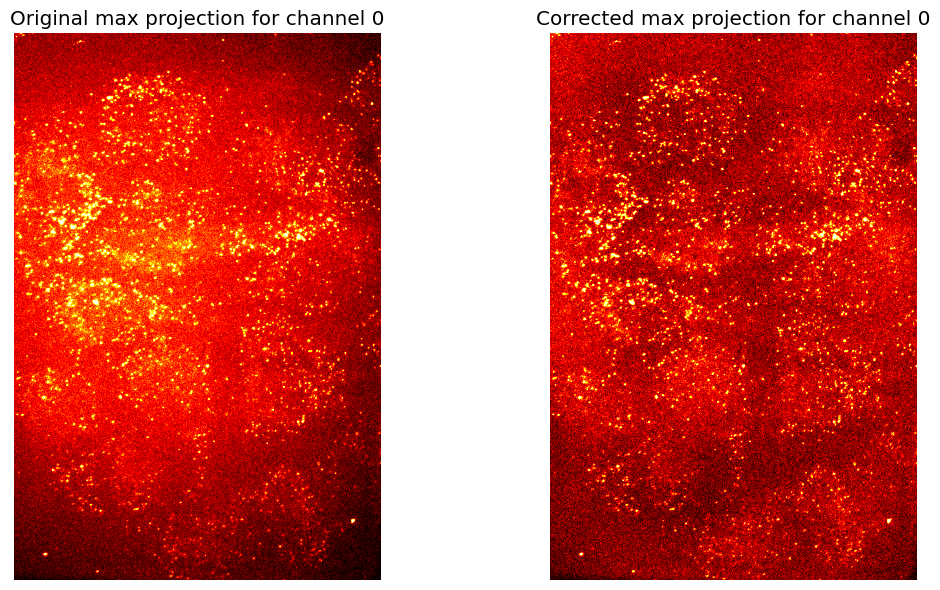

Processing image 25/30...


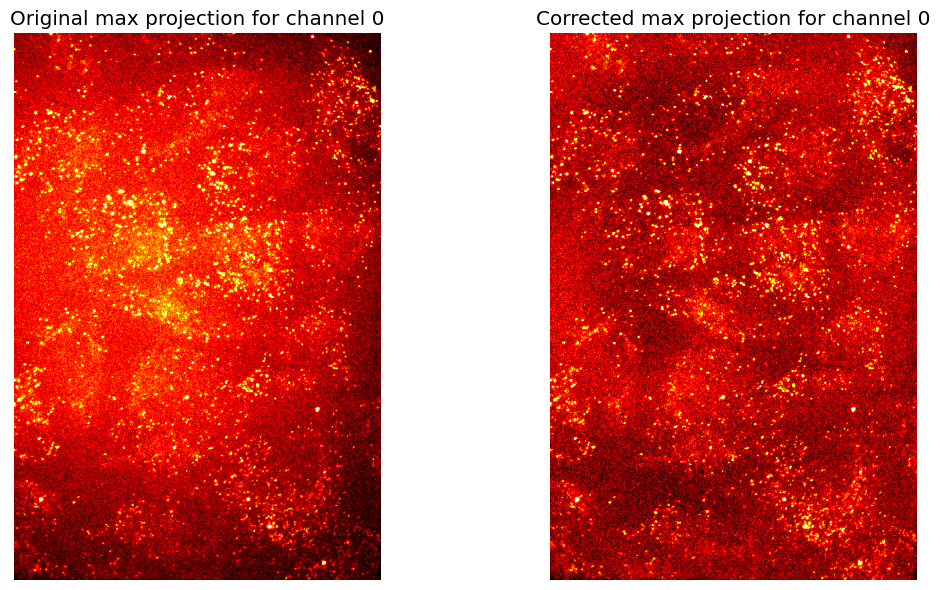

Processing image 26/30...


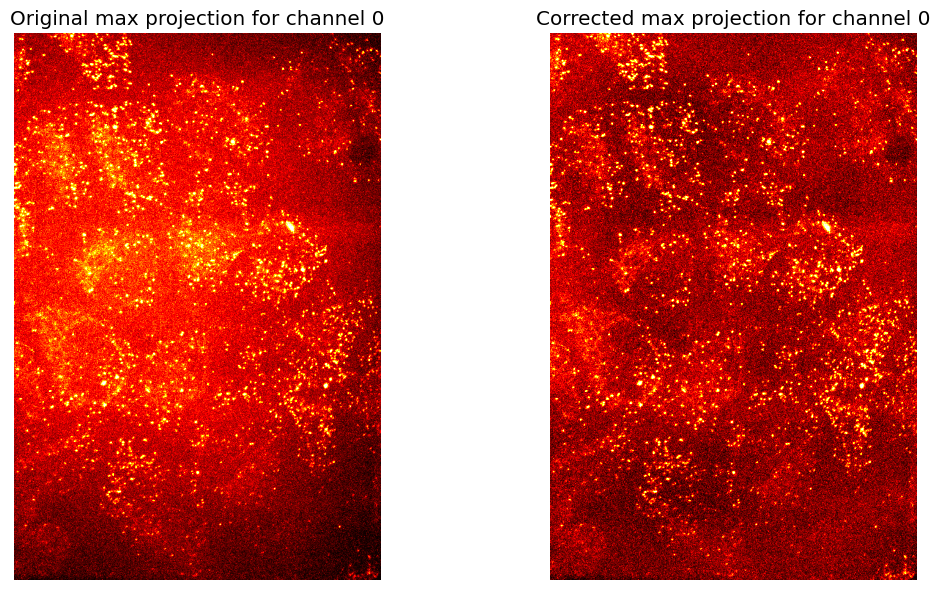

Processing image 27/30...


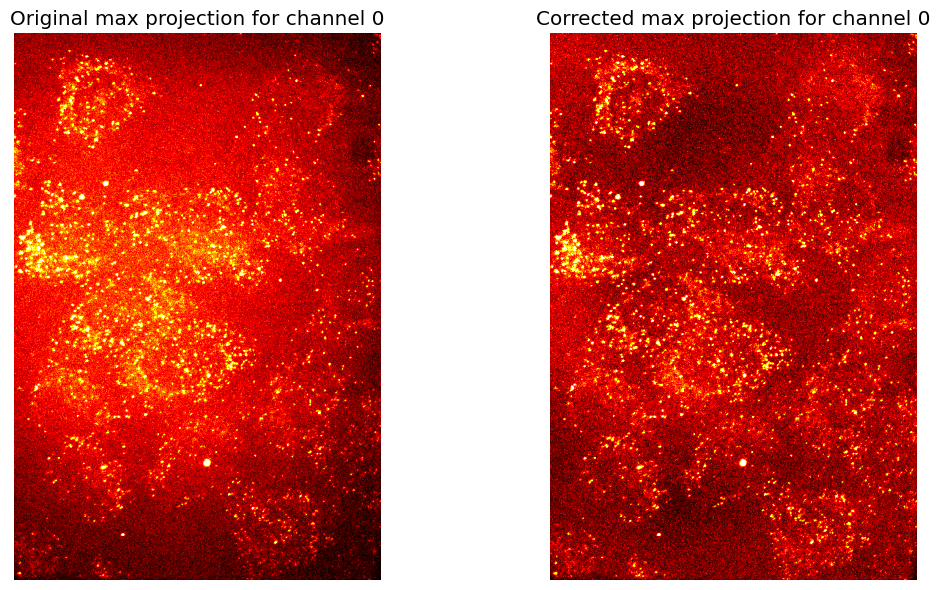

Processing image 28/30...


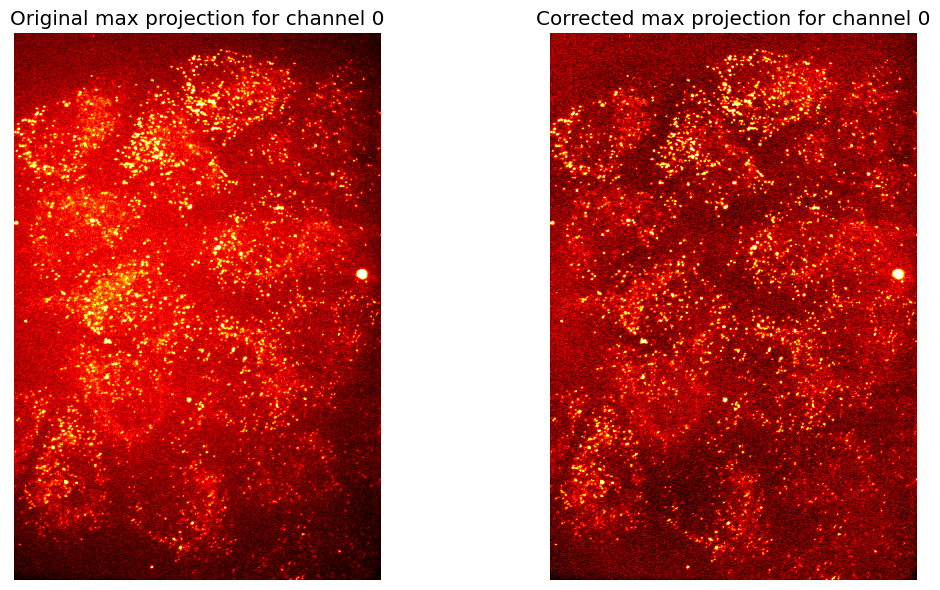

Processing image 29/30...


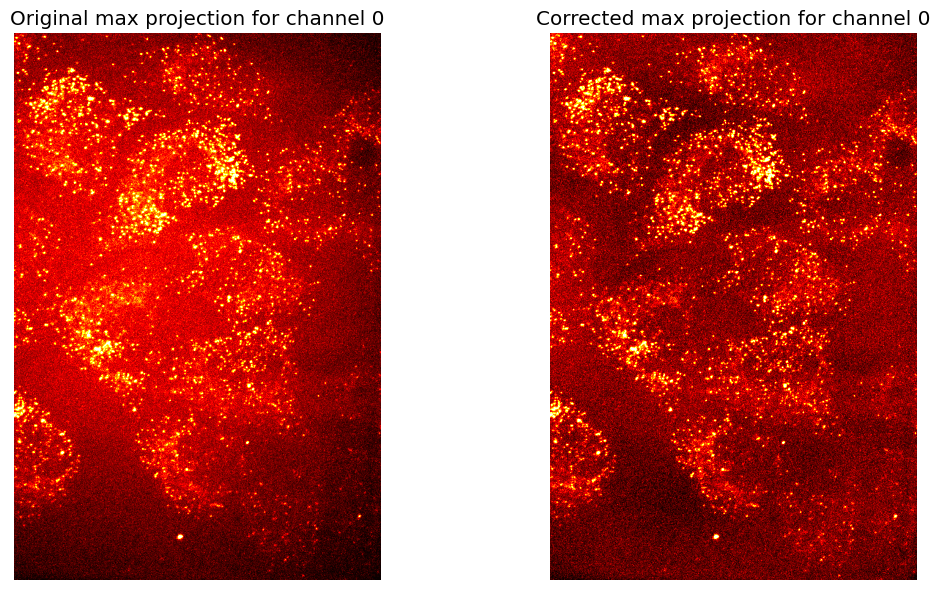

Processing image 30/30...


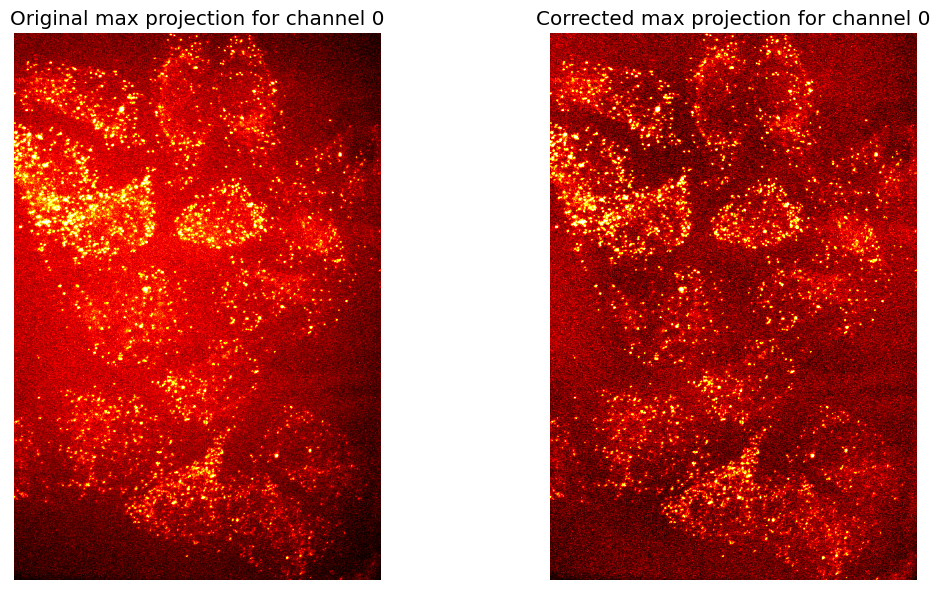

illumination_correction step completed.

 ###################### 
        IMAGE : 0
 ###################### 
    Image Name :   ROI025_XY1683821754_Z00_T0_C1

 ###################### 
        IMAGE : 1
 ###################### 
    Image Name :   ROI005_XY1683820106_Z00_T0_C0

 ###################### 
        IMAGE : 2
 ###################### 
    Image Name :   ROI014_XY1683820745_Z00_T0_C0

 ###################### 
        IMAGE : 3
 ###################### 
    Image Name :   masks_cyto_no_nuclei_ROI026_XY1683821755_Z00_T0_merged

 ###################### 
        IMAGE : 4
 ###################### 
    Image Name :   ROI027_XY1683821756_Z00_T0_C2

 ###################### 
        IMAGE : 5
 ###################### 
    Image Name :   masks_nuclei_ROI012_XY1683820113_Z00_T0_merged

 ###################### 
        IMAGE : 6
 ###################### 
    Image Name :   masks_cyto_no_nuclei_ROI020_XY1683821749_Z00_T0_merged

 ###################### 
        IMAGE : 7
 ######################

In [2]:
## BigFish Spot Detection w/ Illumination Correction

# Define the directories and experiment details
raw_data_dir = r'smFISH_images\Eric_smFISH_images\20230511\DUSP1_DexTimeConcSweep_10nM_75min_041223'

# Build Experiment Class
experiment = Experiment()
experiment.initial_data_location = raw_data_dir
experiment.nucChannel = [2]
experiment.cytoChannel = [1]
experiment.FISHChannel = [0]

# Build Confocal Scope Class
confocal = ScopeClass()
confocal.voxel_size_yx = 160
confocal.voxel_size_z = 500
confocal.spot_yx = 200
confocal.spot_z = 750

# Build Settings Class
pipelineSettings = Settings(local_or_NAS=0, load_in_mask=True) #user_select_number_of_images_to_run=5,
pipelineSettings.bigfish_alpha = 0.7
pipelineSettings.bigfish_beta = 4
pipelineSettings.bigfish_gamma = 5
pipelineSettings.CLUSTER_RADIUS = 500
pipelineSettings.MIN_NUM_SPOT_FOR_CLUSTER = 4
pipelineSettings.display_plots = True
pipelineSettings.show_final_projection = True
pipelineSettings.show_illumination_profile = True
pipelineSettings.verbose = True
pipelineSettings.snr_threshold = 4

# Create the DataContainer
pipelineData = DataContainer()

# Define the pipeline steps
prePipelineSteps = [
    FFF2NativeDataType(), 
    Make_Output_Dir_JF(), 
    Make_Analysis_Dir_JF(), 
    illumination_correction()
]
pipelineSteps = [BIGFISH_SpotDetection()]
postPipelineSteps = [BuildPDFReport(), SaveSpotDetectionResults(), SaveMasksToAnalysis()]

# Create the pipeline
pipeline = Pipeline(pipelineSettings, confocal, experiment, pipelineData, prePipelineSteps, postPipelineSteps, pipelineSteps)

# Run the pipeline up to BIGFISH_SpotDetection
pipeline.run_up_to('BIGFISH_SpotDetection')



 ###################### 
        IMAGE : 0
 ###################### 
    Image Name :   ROI025_XY1683821754_Z00_T0_C1


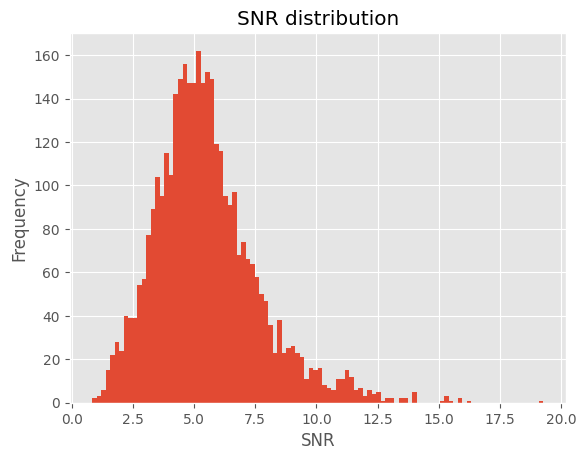

DEBUG:matplotlib.ticker:vmin 0.7230138382356674 vmax 22.534295588953327
DEBUG:matplotlib.ticker:ticklocs array([1.e-02, 1.e-01, 1.e+00, 1.e+01, 1.e+02, 1.e+03])
DEBUG:matplotlib.ticker:vmin 0.7230138382356674 vmax 22.534295588953327
DEBUG:matplotlib.ticker:ticklocs array([2.e-02, 3.e-02, 4.e-02, 5.e-02, 6.e-02, 7.e-02, 8.e-02, 9.e-02,
       2.e-01, 3.e-01, 4.e-01, 5.e-01, 6.e-01, 7.e-01, 8.e-01, 9.e-01,
       2.e+00, 3.e+00, 4.e+00, 5.e+00, 6.e+00, 7.e+00, 8.e+00, 9.e+00,
       2.e+01, 3.e+01, 4.e+01, 5.e+01, 6.e+01, 7.e+01, 8.e+01, 9.e+01,
       2.e+02, 3.e+02, 4.e+02, 5.e+02, 6.e+02, 7.e+02, 8.e+02, 9.e+02,
       2.e+03, 3.e+03, 4.e+03, 5.e+03, 6.e+03, 7.e+03, 8.e+03, 9.e+03])
DEBUG:matplotlib.ticker:vmin 0.7230138382356674 vmax 22.534295588953327
DEBUG:matplotlib.ticker:ticklocs array([1.e-02, 1.e-01, 1.e+00, 1.e+01, 1.e+02, 1.e+03])
DEBUG:matplotlib.ticker:vmin 0.7230138382356674 vmax 22.534295588953327
DEBUG:matplotlib.ticker:ticklocs array([1.e-02, 1.e-01, 1.e+00, 1.e+01, 1.

median SNR: 5.254071017218921
mean SNR: 5.531488720977053


DEBUG:matplotlib.ticker:vmin 0.7230138382356674 vmax 22.534295588953327
DEBUG:matplotlib.ticker:ticklocs array([1.e-02, 1.e-01, 1.e+00, 1.e+01, 1.e+02, 1.e+03])
DEBUG:matplotlib.ticker:vmin 0.7230138382356674 vmax 22.534295588953327
DEBUG:matplotlib.ticker:ticklocs array([2.e-02, 3.e-02, 4.e-02, 5.e-02, 6.e-02, 7.e-02, 8.e-02, 9.e-02,
       2.e-01, 3.e-01, 4.e-01, 5.e-01, 6.e-01, 7.e-01, 8.e-01, 9.e-01,
       2.e+00, 3.e+00, 4.e+00, 5.e+00, 6.e+00, 7.e+00, 8.e+00, 9.e+00,
       2.e+01, 3.e+01, 4.e+01, 5.e+01, 6.e+01, 7.e+01, 8.e+01, 9.e+01,
       2.e+02, 3.e+02, 4.e+02, 5.e+02, 6.e+02, 7.e+02, 8.e+02, 9.e+02,
       2.e+03, 3.e+03, 4.e+03, 5.e+03, 6.e+03, 7.e+03, 8.e+03, 9.e+03])
DEBUG:matplotlib.ticker:vmin 0.7230138382356674 vmax 22.534295588953327
DEBUG:matplotlib.ticker:ticklocs array([1.e-02, 1.e-01, 1.e+00, 1.e+01, 1.e+02, 1.e+03])
DEBUG:matplotlib.ticker:vmin 0.7230138382356674 vmax 22.534295588953327
DEBUG:matplotlib.ticker:ticklocs array([1.e-02, 1.e-01, 1.e+00, 1.e+01, 1.

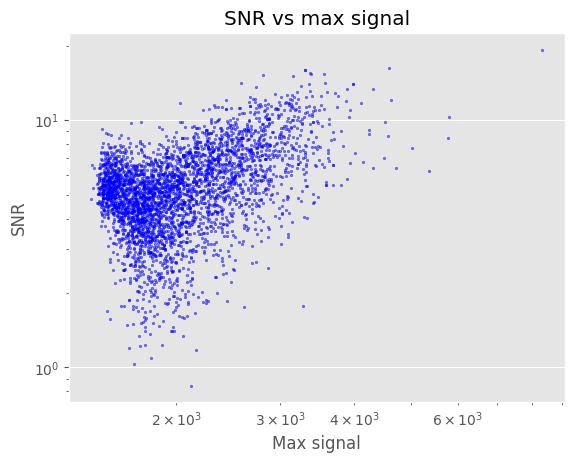

SNR threshold: 4
Number of spots after SNR filtering: 2782
detected canidate spots
 shape: (2782, 3)
 threshold: 5542.0
detected spots after decomposition
 shape: (2795, 3)
detected spots after clustering
 shape: (2795, 4)
detected clusters
 shape: (1, 5)


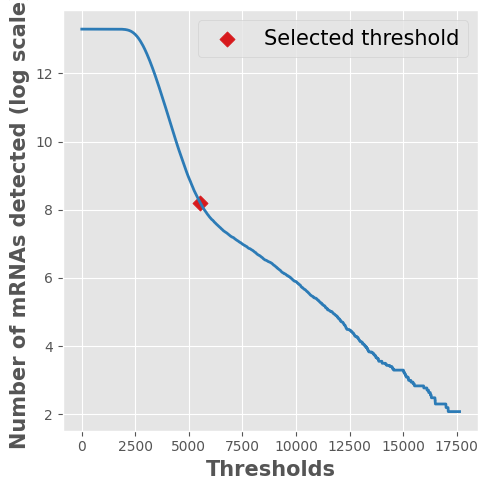

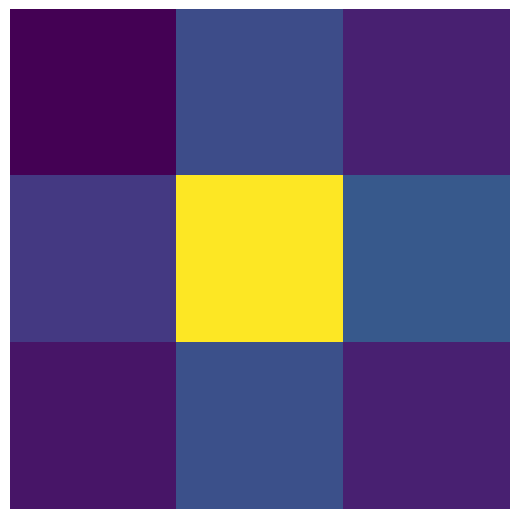

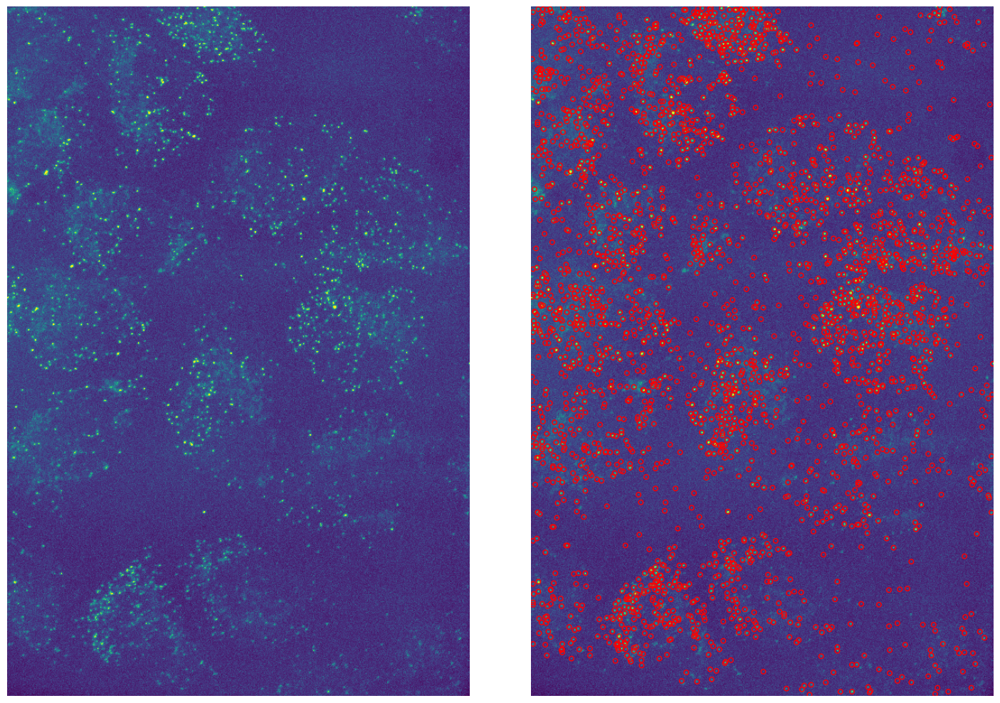

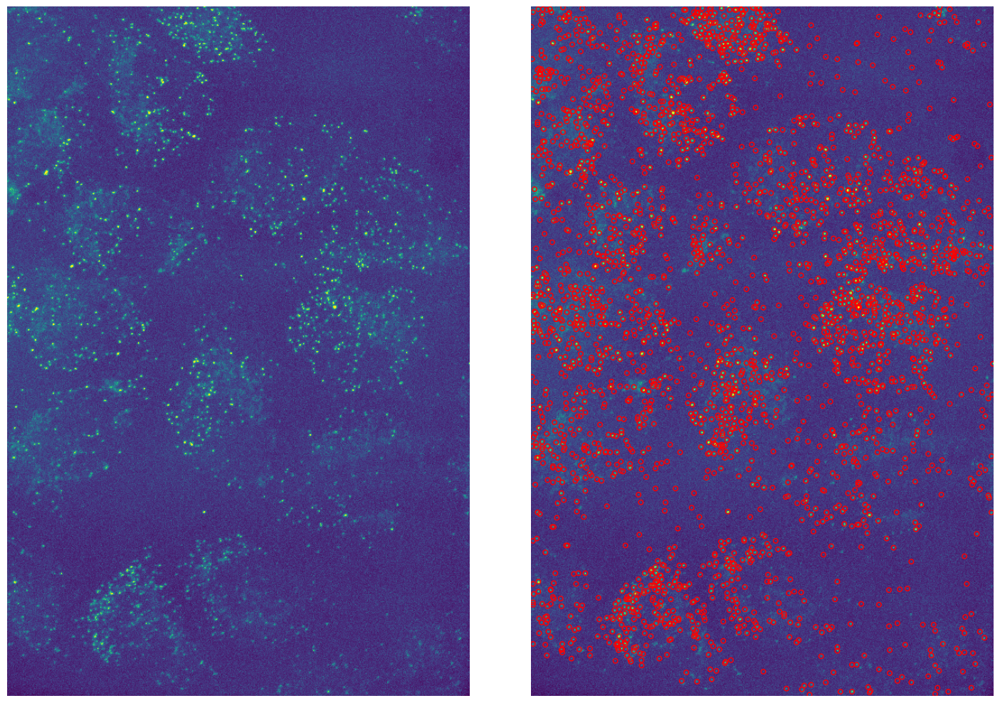

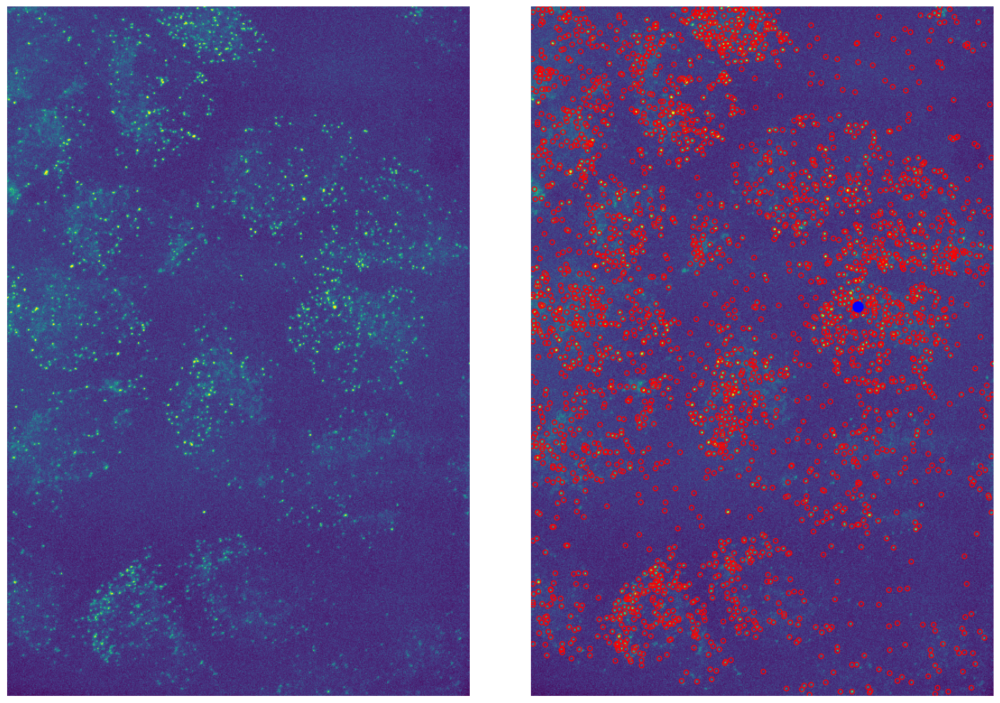

detected spots (without transcription sites)
 shape: (2795, 4)
 dtype: float64
detected spots (inside nuclei)
 shape: (1478, 4)
 dtype: float64 

detected spots (outside nuclei)
 shape: (1317, 4)
 dtype: float64
number of cells identified: 6
cell 0
 number of rna 182
 number of foci 0
 number of transcription sites 0


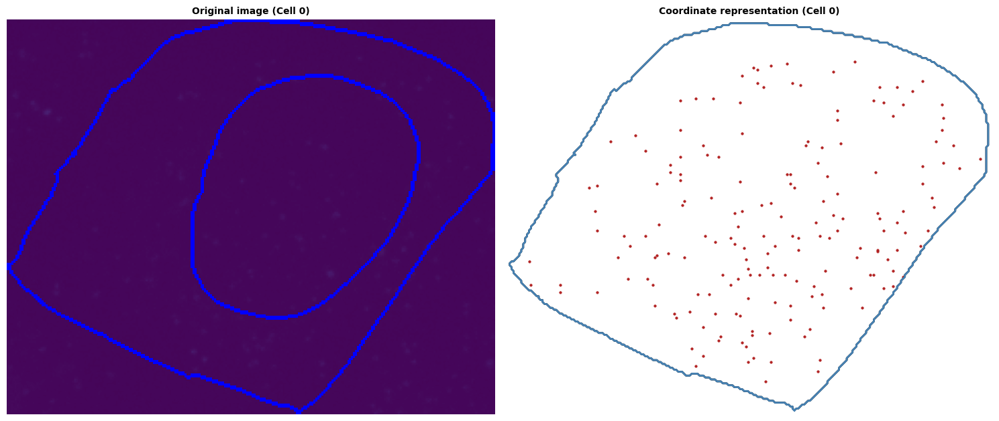

cell 1
 number of rna 124
 number of foci 0
 number of transcription sites 0


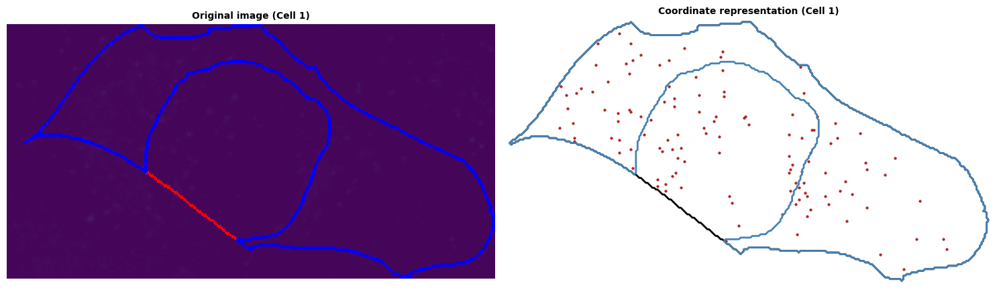

cell 2
 number of rna 280
 number of foci 1
 number of transcription sites 0


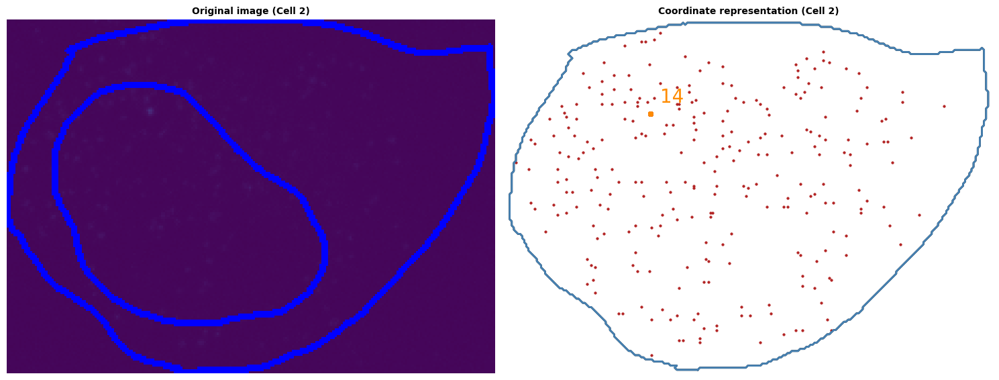

cell 3
 number of rna 210
 number of foci 0
 number of transcription sites 0


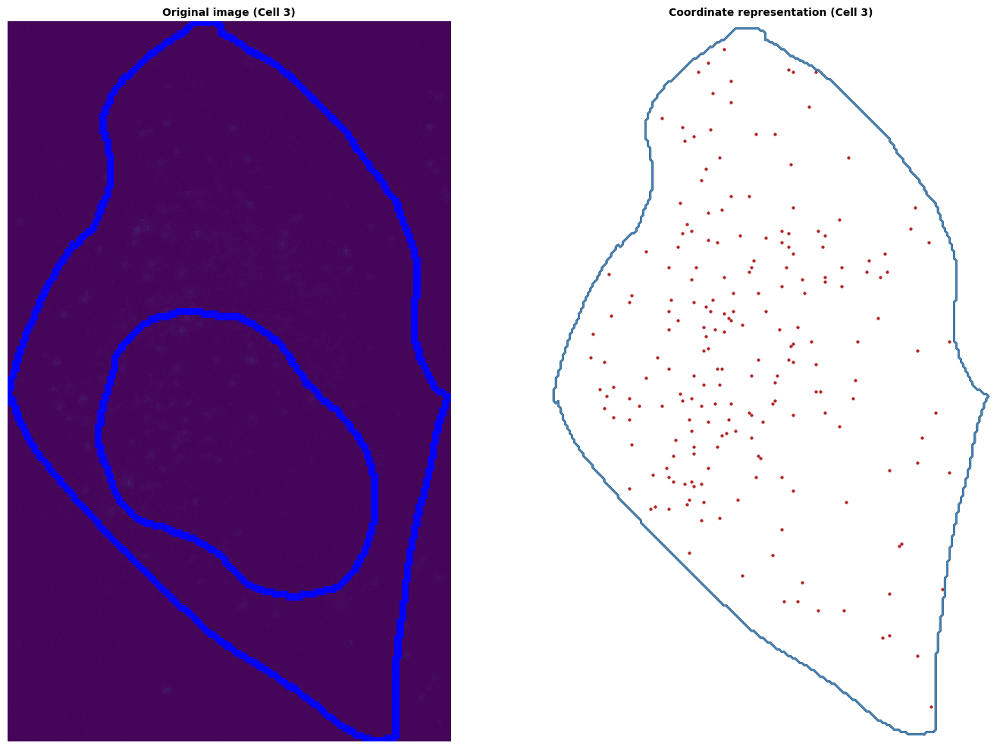

cell 4
 number of rna 117
 number of foci 0
 number of transcription sites 0


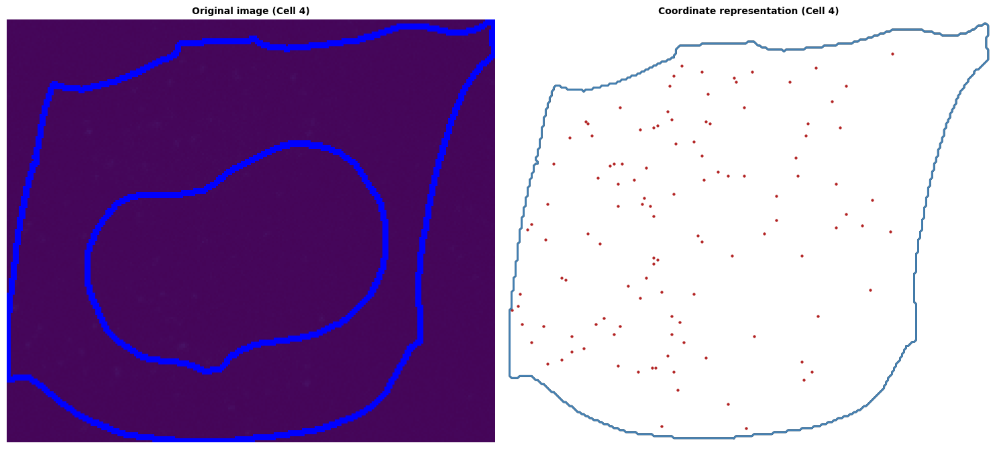

cell 5
 number of rna 113
 number of foci 0
 number of transcription sites 0


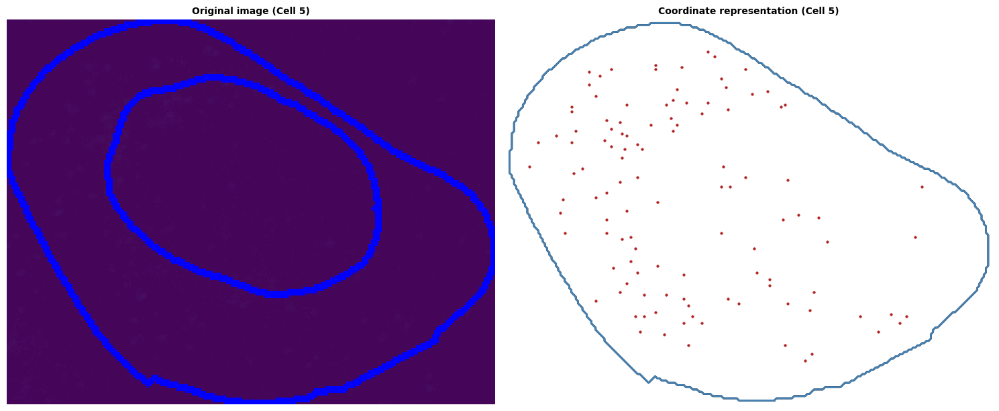


 ###################### 
        IMAGE : 1
 ###################### 
    Image Name :   ROI005_XY1683820106_Z00_T0_C0


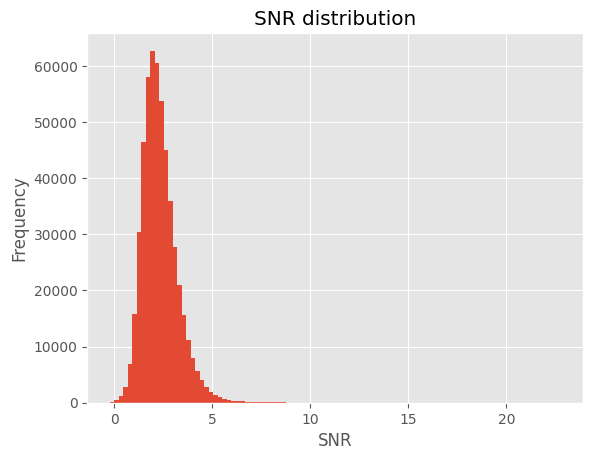

median SNR: 2.2125163017366316
mean SNR: 2.347075048551248


DEBUG:matplotlib.ticker:vmin 0.001900323067545352 vmax 35.60931674948952
DEBUG:matplotlib.ticker:ticklocs array([1.e-04, 1.e-03, 1.e-02, 1.e-01, 1.e+00, 1.e+01, 1.e+02, 1.e+03])
DEBUG:matplotlib.ticker:vmin 0.001900323067545352 vmax 35.60931674948952
DEBUG:matplotlib.ticker:ticklocs array([2.e-04, 3.e-04, 4.e-04, 5.e-04, 6.e-04, 7.e-04, 8.e-04, 9.e-04,
       2.e-03, 3.e-03, 4.e-03, 5.e-03, 6.e-03, 7.e-03, 8.e-03, 9.e-03,
       2.e-02, 3.e-02, 4.e-02, 5.e-02, 6.e-02, 7.e-02, 8.e-02, 9.e-02,
       2.e-01, 3.e-01, 4.e-01, 5.e-01, 6.e-01, 7.e-01, 8.e-01, 9.e-01,
       2.e+00, 3.e+00, 4.e+00, 5.e+00, 6.e+00, 7.e+00, 8.e+00, 9.e+00,
       2.e+01, 3.e+01, 4.e+01, 5.e+01, 6.e+01, 7.e+01, 8.e+01, 9.e+01,
       2.e+02, 3.e+02, 4.e+02, 5.e+02, 6.e+02, 7.e+02, 8.e+02, 9.e+02,
       2.e+03, 3.e+03, 4.e+03, 5.e+03, 6.e+03, 7.e+03, 8.e+03, 9.e+03])
DEBUG:matplotlib.ticker:vmin 0.001900323067545352 vmax 35.60931674948952
DEBUG:matplotlib.ticker:ticklocs array([1.e-04, 1.e-03, 1.e-02, 1.e-01, 1.

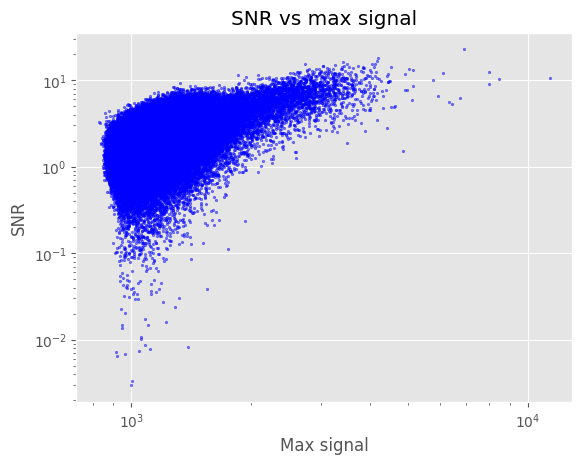

SNR threshold: 4
Number of spots after SNR filtering: 24974
detected canidate spots
 shape: (24974, 3)
 threshold: 2314.0
detected spots after decomposition
 shape: (24974, 3)
detected spots after clustering
 shape: (24974, 4)
detected clusters
 shape: (0, 5)


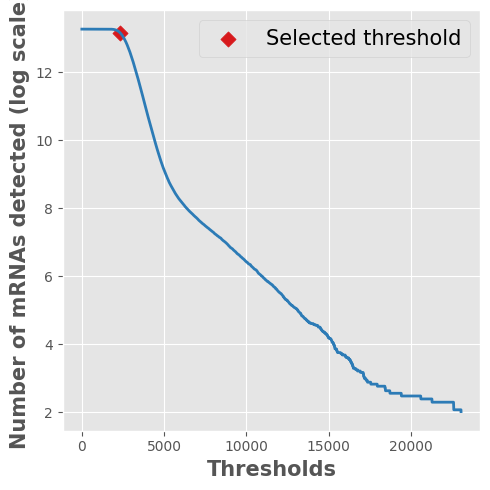

UnboundLocalError: cannot access local variable 'reference_spot' where it is not associated with a value

In [3]:
pipeline.run_single_step(BIGFISH_SpotDetection())

In [ ]:
pipeline.dataContainer.illumination_correction_output.corrected_images



In [ ]:
pipeline.run_up_to('BIGFISH_SpotDetection')
import matplotlib.pyplot as plt
import numpy as np
plt.imshow(np.max(pipelineData.list_images[0], axis=0)[:,:, 0])
plt.show()

In [ ]:
pipeline.run_up_to('BuildPDFReport')
import matplotlib.pyplot as plt
import numpy as np
plt.imshow(np.max(pipelineData.list_images[0], axis=0)[:,:, 0])
plt.show()